In [1]:
%matplotlib inline


from keras.models import Model
from keras import backend as K
from keras.callbacks import TensorBoard, EarlyStopping
from keras.layers import LSTM, Dropout, Dense, BatchNormalization, Activation, Input, TimeDistributed
from keras.regularizers import l1,l2
from keras.layers.advanced_activations import LeakyReLU, ELU, PReLU
from keras.optimizers import RMSprop, Adam, Adadelta, Adagrad
from keras.utils import to_categorical
import numpy as np
from time import time
from matplotlib import pyplot as plt
import random as rn
import tensorflow as tf
from assignment.helpers import datapreparation as prep

# Seed session
np.random.seed(123456)
rn.seed(123456)
session_conf = tf.ConfigProto(intra_op_parallelism_threads=0,
                              inter_op_parallelism_threads=0)
from keras import backend as K
tf.set_random_seed(123456)
sess = tf.Session(graph=tf.get_default_graph(), config=session_conf)
K.set_session(sess)
##

fs1_dirpath = "./assignment/datasets/training/piano_roll_fs1"
fs5_dirpath = "./assignment/datasets/training/piano_roll_fs5"


# Load initial data
datasets = prep.load_all_dataset(fs5_dirpath)
dataset_names = prep.load_all_dataset_names(fs5_dirpath)
unique_names = set()
for name in dataset_names: # Make sure the same names get the same encoding each run
    unique_names.add(name)
unique_names = list(unique_names)
name_to_int = dict([(unique_names[i], i) for i in range(len(unique_names))])
int_to_name = dict([(i, unique_names[i]) for i in range(len(unique_names))])
dataset_names = to_categorical([name_to_int[name] for name in dataset_names]) # one-hot encode the composers
datasets = [dataset[:, 1:] for dataset in datasets] # Remove the headers

# Setting initial parameters
dataset_id_names = dict(zip(np.arange(len(dataset_names)), dataset_names))
longest_song = max(datasets[i].shape[1] for i in range(len(datasets)))
sequence_length = 50
length = longest_song//sequence_length + 1
num_keys = len(datasets[0])
parts_per_song = int(longest_song/sequence_length)
composer_encoding_len=len(dataset_names[0]) # 4 composers

# Makes several datasets from this first one with differing intervals between to capture the "gaps" between two sequences
# Add each subsequence of each song with differing offsets ([0:10], [1:11], [2:12], ...) to retain information.
# Unable to implement stateful, so try to retain as much information between subsequences as possible. 
# Also a way of dataset augmentation (regularization) by increasing the size of the dataset

def transpose_and_label_more(dataset_names, datasets, num_keys):
    zs = []
    datasets_transposed = np.array([(datasets[i].T, dataset_names[i]) for i in range(len(datasets))])
    for song, composer in datasets_transposed:
        for offset in range(0, sequence_length, 10): # Consider dropping offset, and use stateful to retain this info!
            for i in range(0, len(song)//sequence_length-offset):
                x = song[offset+i*sequence_length:offset+(i+1)*sequence_length]
                if i == len(song)//sequence_length - (1 + offset): # Add the EOF marker if last seq of song
                    y = np.append(song[offset+i*sequence_length+1:offset+(i+1)*sequence_length], np.array([np.ones(num_keys)]), 0)
                else:
                    y = song[offset+i*sequence_length+1:offset+(i+1)*sequence_length+1]
                zs.append((x, y, composer))
    xs, ys, composers = [], [], []
    for x, y, composer in zs:
        xs.append(x)
        ys.append(y)
        composers.append(composer)
    return np.array(xs), np.array(ys), np.array(composers)

train_xs, train_ys, train_composers = transpose_and_label_more(dataset_names, datasets, num_keys)
print(train_ys.shape)

Using TensorFlow backend.


(3342, 50, 128)


In [2]:
specialist_input = Input(shape=(composer_encoding_len,))
x = Dense(32, activation="relu")(specialist_input) # Change the activation function within as the sigmoid quickly saturates due to shape. It's ok as output though.
specialist_output_h = Dense(num_keys, activation="relu")(x)
specialist_output_c = Dropout(0.2)(specialist_output_h)

inputs = Input(shape=(sequence_length, num_keys))

# Units = units per timestep LSTM block, i.e. output dimensionality (128 here since input and output 128 keys)
lstm1 = LSTM(num_keys,
               activation='relu',
               return_sequences=True)(inputs)
#lstm1_outputs = lstm1(inputs, initial_state=[specialist_output_h, specialist_output_c]) # [h = prev output, c = memory], h should be None

lstm2 = LSTM(num_keys,
               activation='relu',
               return_sequences=True)(lstm1)

normalized2 = BatchNormalization()(lstm2)
outputs = TimeDistributed(Dense(num_keys, activation="sigmoid"))(normalized2) 
# Sigmoid keeps the probabilities independent of each other, while softmax does not!
# kernel_regularizer = regulizer on weights
# activity_regularizer = regularizer on outputs aka activations

model = Model(inputs, outputs)

adam = Adam(lr=0.001, amsgrad=True) 
# Ends up in a point where gradients really small, denominator really small and then loss exploding
# v_t is based on the gradients at the current time step, and previous v_t, thus when gradient really small as well as v_t-1
# the update denominator (sqrt(v_t) + epsilon) is so small that explodes.
# AMSGrad maintains the maximum of all v_t until the present time step and uses this maximum value for normalizing
# the running average of the gradient instead of the current v_t as is done in regular Adam.


In [3]:
# Want to penalize each output node independantly. 
# Log Loss aka multi-class multi-label as sigmoid -> binary CE, as want probs to be considered independent of each other.
# Combo of sigmoid and crossentropy here log counteracts exp to reduce the saturation :)
model.compile(loss='binary_crossentropy',
              optimizer=adam, # consider changing this one for others
              metrics=['categorical_accuracy'])
print(model.summary())

tensorboard = TensorBoard(log_dir="./logs/{}".format(time()))
early_stop = EarlyStopping(monitor="val_loss", min_delta=0, patience=3, verbose=0, mode="auto")

print(train_xs.shape, train_composers.shape, train_ys.shape)
model.fit(train_xs, train_ys,
          epochs=100, # Train harder more for more things was too bad train man :(
          batch_size=32,
          shuffle=True, # shuffle here but not when constructing set to be able to validate later on :)
          #callbacks=[tensorboard],
          )

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 50, 128)           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 50, 128)           131584    
_________________________________________________________________
lstm_2 (LSTM)                (None, 50, 128)           131584    
_________________________________________________________________
batch_normalization_1 (Batch (None, 50, 128)           512       
_________________________________________________________________
time_distributed_1 (TimeDist (None, 50, 128)           16512     
Total params: 280,192
Trainable params: 279,936
Non-trainable params: 256
_________________________________________________________________
None
(3342, 50, 128) (3342, 4) (3342, 50, 128)
Epoch 1/100
3342/3342 [==============================] - 14s 4ms/step - loss: 0.4568 - 

3342/3342 [==============================] - 12s 4ms/step - loss: 0.0388 - categorical_accuracy: 0.2430
Epoch 63/100
3342/3342 [==============================] - 12s 4ms/step - loss: 0.0385 - categorical_accuracy: 0.2446
Epoch 64/100
3342/3342 [==============================] - 12s 4ms/step - loss: 0.0384 - categorical_accuracy: 0.2447
Epoch 65/100
3342/3342 [==============================] - 12s 4ms/step - loss: 0.0388 - categorical_accuracy: 0.2438
Epoch 66/100
3342/3342 [==============================] - 12s 4ms/step - loss: 0.0384 - categorical_accuracy: 0.2465
Epoch 67/100
3342/3342 [==============================] - 12s 4ms/step - loss: 0.0383 - categorical_accuracy: 0.2448
Epoch 68/100
3342/3342 [==============================] - 12s 4ms/step - loss: 0.0379 - categorical_accuracy: 0.2473
Epoch 69/100
3342/3342 [==============================] - 12s 3ms/step - loss: 0.0379 - categorical_accuracy: 0.2476
Epoch 70/100
3342/3342 [==============================] - 12s 4ms/step - loss

3342/3342 [==============================] - 5s 1ms/step


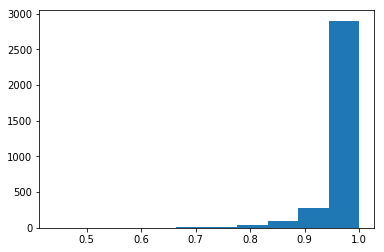

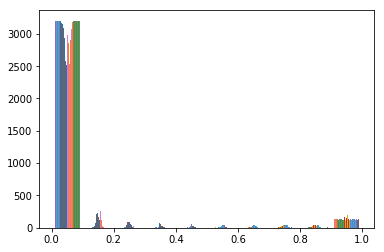

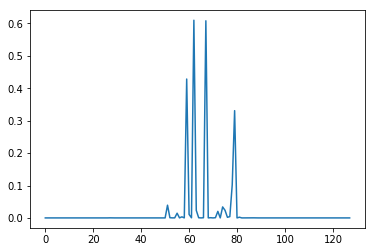

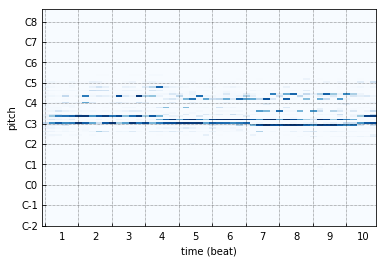

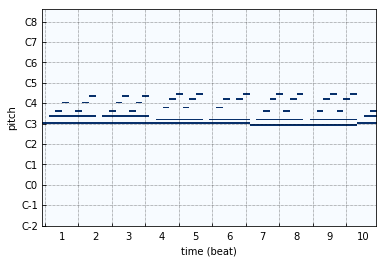

...

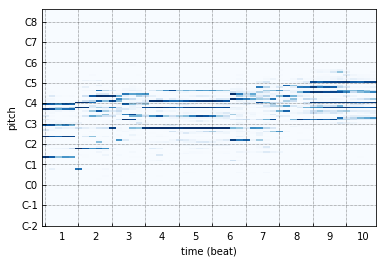

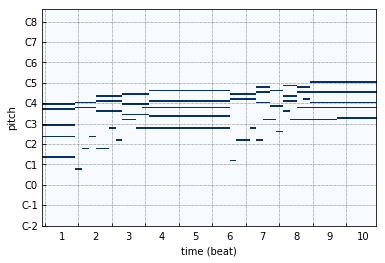

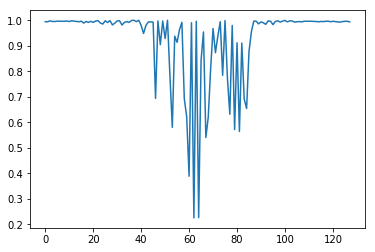

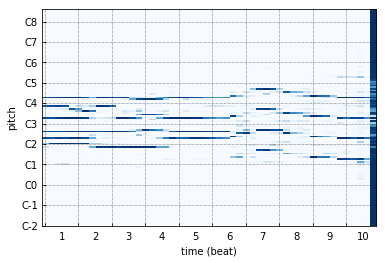

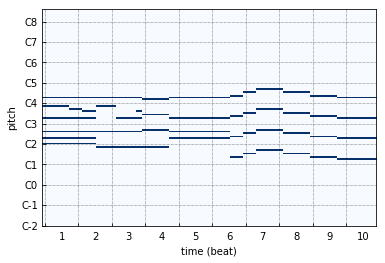

In [5]:
a = model.predict(train_xs, verbose=True)
maxes = [np.max(c) for c in a]
plt.hist(maxes)
plt.show()
plt.hist(a[:,-1])
plt.show()
b = np.max(a[1][-1])
plt.plot(a[1][-1])
plt.show()
prep.visualize_piano_roll(a[0].T, fs=5)
prep.visualize_piano_roll(train_xs[0].T, fs=5)
plt.plot(a[100][-1])
plt.show()
prep.visualize_piano_roll(a[100].T, fs=5)
prep.visualize_piano_roll(train_xs[100].T, fs=5)
plt.plot(a[200][-1])
plt.show()
prep.visualize_piano_roll(a[200].T, fs=5)
prep.visualize_piano_roll(train_xs[200].T, fs=5)

In [6]:
model.save("./models/nostate_fs5_50_generalist.h5f")

In [7]:
def make_song_from_predict(model, initial_data, limit):
    song = []
    keep_producing = True
    prev_data = initial_data
    while keep_producing and len(song) < limit:
        predictions = model.predict(np.array([prev_data]))[0]
        labels = np.zeros(predictions[-1].shape)
        labels[predictions[-1]/np.max(predictions[-1])>0.75] = 1 # Threshold to consider the key as active, binarized based on this
        last_output = labels
        keep_producing = np.sum(last_output) != len(last_output)
        song.append(last_output)
        prev_data = np.append(prev_data[1:], [last_output], 0)
    return np.array(song)

initial_step = 543
steps = 10
song1 = make_song_from_predict(model, train_xs[initial_step], sequence_length*steps)
prep.embed_play_v1(song1.T, fs=5)


In [8]:
prep.embed_play_v1(song2.T, fs=5)

In [9]:
prep.embed_play_v1(song3.T, fs=5)

In [10]:
prep.embed_play_v1(song4.T, fs=5)

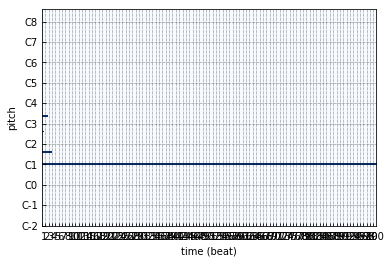

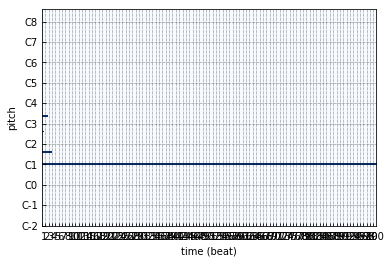

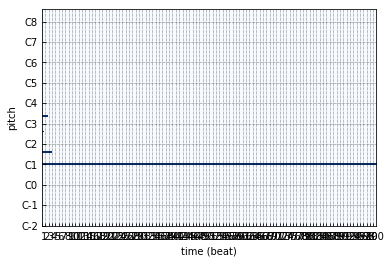

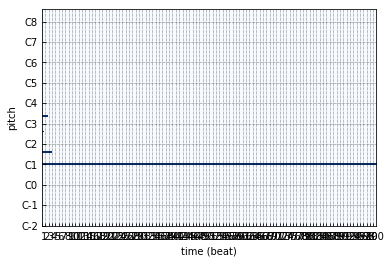

In [11]:
prep.visualize_piano_roll(song1.T, fs=5)
prep.visualize_piano_roll(song2.T, fs=5)
prep.visualize_piano_roll(song3.T, fs=5)
prep.visualize_piano_roll(song4.T, fs=5)